# Bert Topic

BERTopic is a topic modeling technique that leverages 🤗 transformers and c-TF-IDF to create dense clusters allowing for easily interpretable topics whilst keeping important words in the topic descriptions.

BERTopic can be viewed as a sequence of steps to create its topic representations. There are five steps to this process:

![image.png](./plots/bertopic.png)

1. Embeddings 
- convert documents into numerical vectors 
2. Dimensionality Reduction 
- reduce the dimensionality of the embeddings for ease of processing and clustering
3. Clustering 
- cluster the embeddings into topics using a clustering algorithm
4. Tokenizer 
- extract the most important words for each topic
5. Weighting Scheme 
- assign weights to each word in a topic based on their importance
6. Representation Tuning with or without Large Language Models (LLM) 
- fine-tune the topic representation (naming, labels etc)

## Stack used

1. Hugging Face Sentence Transformers for embeddings 
- Open-source, easy to use, powerful for small-medium documents and paragraphs
2. UMAP for dimensionality reduction 
- Fast, scalable, and powerful for high-dimensional data also recommended by the authors of BERTopic
3. HDBSCAN for clustering 
- Very efficient for topic modeling (recommended by the authors of BERTopic)
4. CountVectorizer for tokenization 
- The tokenizer used to calculate to split the document into segments
used to count the length of a document.
5. c-TF-IDF for topic representation from bag-of-words matrix
- TF-IDF was adjusted to work on a cluster/categorical/topic level instead of a document level.
5. Large Language Models (LLM) for fine-tuning the topic representation 
- BERT, OpenAI's GPT-3.5 with custom prompt

In [1]:
import sys
import os
# Get the current working directory
current_dir = os.getcwd()
# Add the parent directory of 'scrapping' to the system path
sys.path.append(os.path.abspath(os.path.join(current_dir, '..', 'scrapping')))
from text_cleaner import read_and_clean_adrs

from nltk.corpus import stopwords
from markdown2 import markdown
import openai
from bertopic import BERTopic
from bertopic.representation import MaximalMarginalRelevance, OpenAI
from sentence_transformers import SentenceTransformer
from bertopic.representation import KeyBERTInspired
import datamapplot

import warnings
warnings.filterwarnings('ignore')

# load environment variables
from dotenv import load_dotenv
load_dotenv()

# Path to the ADR directory
adr_directory = "../../data/ADRs-Updated"

In [2]:
cleaned_texts = read_and_clean_adrs(adr_directory, save=True)

# Fine tuning

# Embedding pre-calculations to speed up the training

In [3]:
# Pre-calculate embeddings --> exmperiment with heavier more accurate models (see best practices)

models = [
    "all-mpnet-base-v2", # longer than miniLM
    "all-MiniLM-L6-v2",
    "voyage-lite-02-instruct"
]


embedding_model = SentenceTransformer("all-mpnet-base-v2")
embeddings = embedding_model.encode(cleaned_texts, show_progress_bar=True)

Batches:   0%|          | 0/168 [00:00<?, ?it/s]

## Use gpt and generative ai as representation model to generate titles for topics

In [4]:
prompt = """
I have a topic that contains the following documents: 
[DOCUMENTS]
The topic is described by the following keywords: [KEYWORDS]

Based on the information above, extract a short topic label in the following format:
topic: <topic label>
the topic label must be at most 5 words long strictly, it must not contain specific names of technologies or programming languages. The documents are related to software development. They are architectural
decision records (ADRs) that describe the decisions made in the development of software systems. The keywords are extracted from the documents.
The topic labels should be general enough but will need to differantiate between
decision categories such as component decisions, programming language or framework decisions,
security, performance, scalability, infrastructure, deployment, testing, formating, standands, etc.
"""

# GPT as representation model ~0.10$ per run
client = openai.OpenAI(api_key=os.getenv("OPEN_AI_API_KEY"))
open_ai_repr_model = OpenAI(client, model="gpt-3.5-turbo", chat=True, prompt=prompt, tokenizer="vectorizer")

## Chaining representation models

In [5]:
# MMR considers the similarity of keywords/keyphrases with the document, along with the similarity of already selected keywords and keyphrases.
# This results in a selection of keywords that maximize their within diversity with respect to the document.
mmr = MaximalMarginalRelevance(diversity=0.3)
representation_models = [mmr, open_ai_repr_model]

## Multiple representation models

In [6]:
# The main representation of a topic
# Use a KeyBERT-like model to fine-tune the topic representations
# The algorithm follows KeyBERT but does some optimization in order to speed up inference.
keybert_repr = KeyBERTInspired()

# Add all models together to be run in a single `fit`
representation_model = {
   "Main": open_ai_repr_model,
   "Keywords":  keybert_repr,
}

# Control cluster size by HDBSCAN min_cluster_size

In [7]:
from hdbscan import HDBSCAN

# A higher min_cluster_size will generate fewer topics and a lower min_cluster_size will generate more topics.
hdbscan_model = HDBSCAN(min_cluster_size=40, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

# Prevent Stochasticity by using a fixed seed on UMAP

In [8]:
from umap import UMAP

umap_model = UMAP(n_neighbors=15, n_components=5, min_dist=0.0, metric='cosine', random_state=42)

In [21]:
# Parameters:
# 1) custom gpt prompt, model="gpt-3.5-turbo", tokenizer="vectorrizer"
# 2) nr_topics= auto or 10 (best) ---> Play around with this parameter to get the best results
# 3) min_topic_size=12 ---> Play around with this parameter to get the best results
# 4) top_n_words=10 ---> Think this is good
# 5) n_gram_range=(1, 2) ---> Think this is good
# 6) language="english"
# 7) calculate_probabilities=True

# To implement and test:
# 7) Outlier Reduction --> By default, HDBSCAN generates outliers which is a helpful mechanic in
# creating accurate topic representations. However, you might want to assign every single document to a topic.
# We can use .reduce_outliers to map some or all outliers to a topic:
# 8) Merge similar topics manually after performing the clustering --> 
# topics_to_merge = [1, 2]
# topic_model.merge_topics(docs, topics_to_merge)


bert_topic_1 = BERTopic(
                        # hyperparameters 
                        language="english", # language of the documents
                        # nr_topics=10, # number of topics to output (this reduces topic AFTER they have been discovered)
                        top_n_words=10, # number of top words per topic
                        n_gram_range=(1, 2), # number of words per n-gram (n_grams are phrases of n words)
                        min_topic_size=12,  # minimum number of data points per topic (more = less topics)
                        # models and embeddings
                        umap_model=umap_model, 
                        hdbscan_model=hdbscan_model,
                        representation_model=representation_model,
                        embedding_model=embedding_model,
                        # other
                        calculate_probabilities=True, # calculate the probs of a document belonging to a topic (slows down training, use when good results are found)
                        )
topics, probs = bert_topic_1.fit_transform(cleaned_texts)

## Note: 
- When testing the model with a lot of topics, the clusters are very small (<20 ADRs) and the topics can relate to specific technologies or tools without providing much information about the context or architecture.

- Maybe find balance between the number of topics by tweaking the min_cluster_size.

In [22]:
bert_topic_1.visualize_documents(cleaned_texts, embeddings=embeddings)

In [23]:
bert_topic_1.get_topic_info()

,Topic,Count,Name,Representation,Keywords,Representative_Docs
0,-1,2575,-1_Configuration Data Model Decision,[Configuration Data Model Decision],"[api, database, implement, implementation, inf...",[firebase infrastructure deciders eimi james a...
1,0,562,0_Frontend Component Architecture,[Frontend Component Architecture],"[react, webpack, component, npm, framework, fr...",[create new react application setting redesign...
2,1,253,1_Architecture Decision Records,[Architecture Decision Records],"[architectural record, architecture record, do...",[documenting architecture architecture agile p...
3,2,246,2_User Authentication Architecture,[User Authentication Architecture],"[access control, authorization, oauth, authent...",[determine new authentication system open appa...
4,3,216,3_Test Scope Clarification,[Test Scope Clarification],"[test suite, testing framework, unit testing, ...",[title follow test pyramid area productoperati...
5,4,171,4_Release Management Process,[Release Management Process],"[feature branch, versioning, github, git, gith...",[new release process updating release process ...
6,5,169,5_Data Schema Evolution Strategy,[Data Schema Evolution Strategy],"[database, postgres, schema, postgresql, mongo...",[adr supporting nosql backends jean cochrane o...
7,6,143,6_Decentralized Communication Protocol,[Decentralized Communication Protocol],"[cosmos sdk, sdk, implement, protocol, module,...",[adr core module api changelog first draft fir...
8,7,134,7_API Schema Versioning Approach,[API Schema Versioning Approach],"[version api, openapi specification, apis, api...",[adrapidocumentation title api documentation g...
9,8,107,8_Monitoring Architecture Decisions,[Monitoring Architecture Decisions],"[monitoring, cloudwatch, telemetry, logging, c...",[log cache clock issue issue motivating influe...


In [24]:
bert_topic_1.visualize_topics()

In [25]:
bert_topic_1.visualize_heatmap()

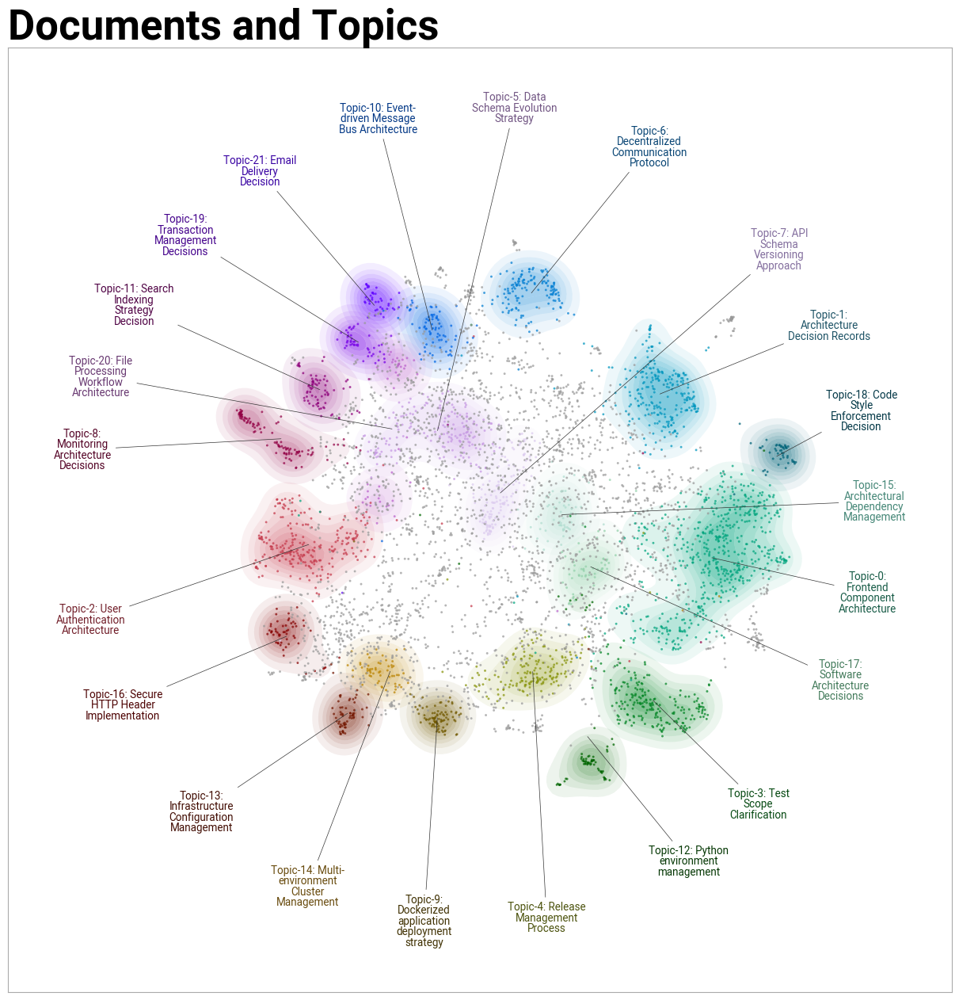

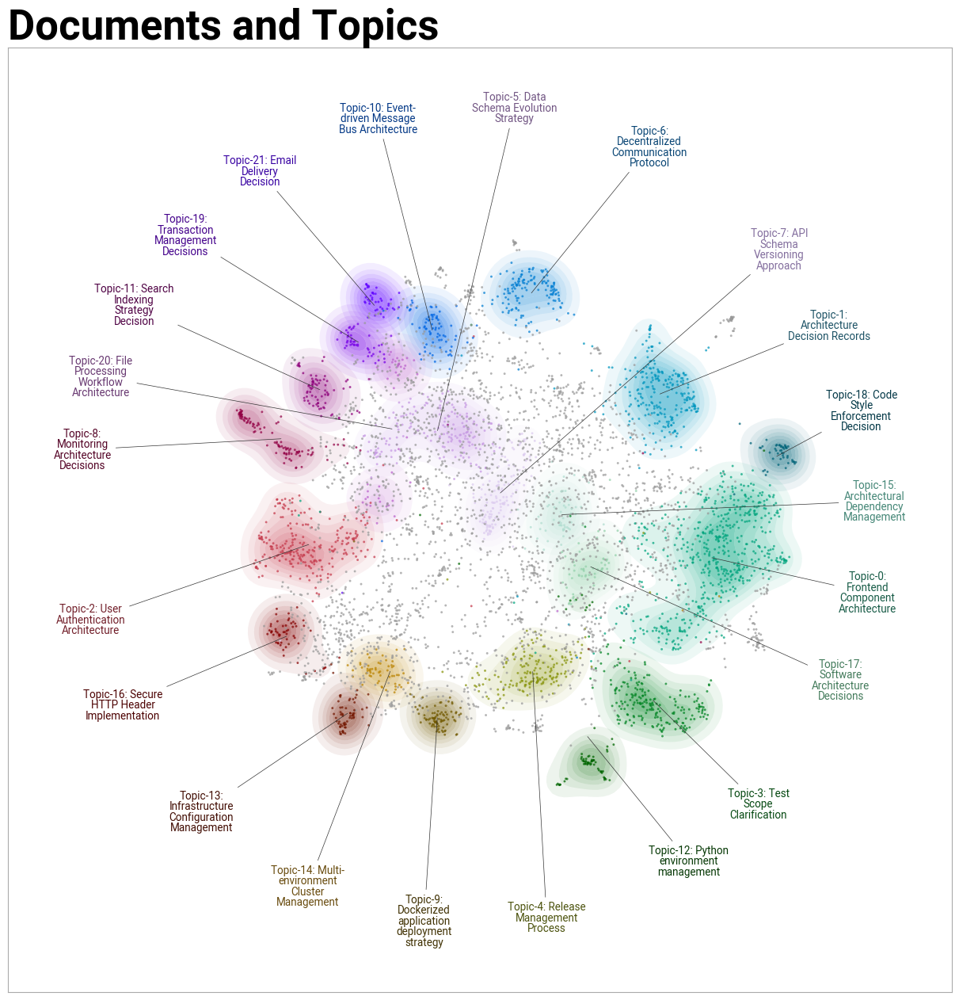

In [26]:
bert_topic_1.visualize_document_datamap(cleaned_texts, embeddings=embeddings)

In [15]:
bert_topic_1.visualize_hierarchy()

## Wordclouds

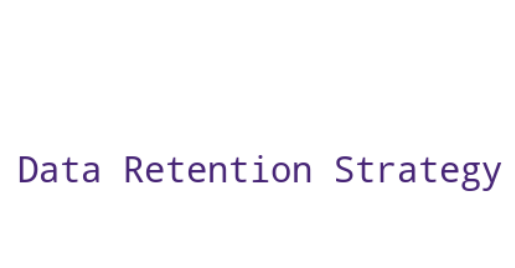

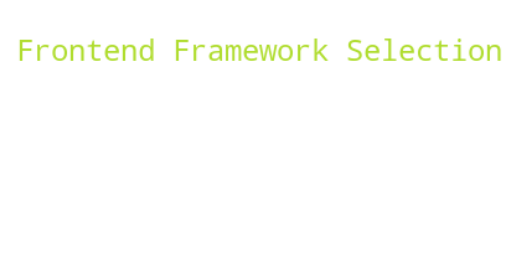

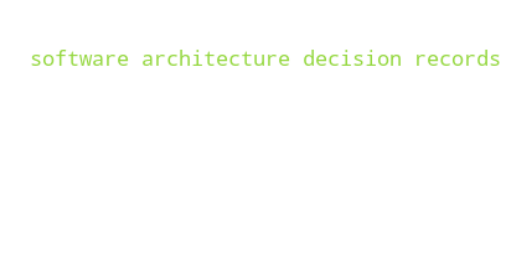

In [16]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def create_wordcloud(model, topic):
    text = {word: value for word, value in model.get_topic(topic)}
    wc = WordCloud(background_color="white", max_words=1000)
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

for i in range(3):
    create_wordcloud(bert_topic_1, i)

# Term search in topics

In [17]:
import random
search_terms = ["security", "aws", "cloud",
                "database", "encryption", "network", "server",
                "api", "docker", "kubernetes" , "module" , "connectors",
                "authentication", "authorization", "http" , "testing", "javascript"
                "frontend", "backend", "fullstack", "devops", "agile", "scrum",
                "data", "bigdata", "analytics", "machinelearning", "database"]

search_term = random.choice(search_terms)
print(f"Search Term: {search_term}")
print("Most similar topics:")
similar_topics, similarity = bert_topic_1.find_topics(search_term=search_term, top_n=3)
for topic, sim in zip(similar_topics, similarity):
    print("----------------------------------------------")
    print(f"Topic {topic} with similarity {sim}")
    print("Main KeyBert Representation:")
    print(bert_topic_1.get_topic(topic, full=True)["Main"][:3])
    print("OpenAI Representation:")
    print(bert_topic_1.get_topic(topic, full=True)["Keywords"])

Search Term: backend
Most similar topics:
----------------------------------------------
Topic -1 with similarity 0.40651604533195496
Main KeyBert Representation:
[('Infrastructure Decision Making', 1)]
OpenAI Representation:
[('api', 0.43922463), ('aws', 0.35560533), ('repository', 0.3313313), ('implementation', 0.30268475), ('server', 0.29857847), ('client', 0.2952651), ('platform', 0.29023513), ('database', 0.28937286), ('deployment', 0.2787677), ('service', 0.27355748)]
----------------------------------------------
Topic 0 with similarity 0.3691748380661011
Main KeyBert Representation:
[('Data Retention Strategy', 1)]
OpenAI Representation:
[('schema', 0.42605296), ('implement', 0.39798546), ('database', 0.3978238), ('implementation', 0.36973754), ('api', 0.32827014), ('module', 0.32045728), ('information', 0.31859827), ('json', 0.3110037), ('interface', 0.28432298), ('data', 0.2783058)]
----------------------------------------------
Topic 3 with similarity 0.3637390732765198
Main

# Prominent Topics From Many Runs and Methods
- Topic 1: Cloud and Infrastructure --> prevalent in all tries

- Topic 2: Data and data storage --> prevalent in almost all tries

- Topic 3: Programming language and frameworks --> Have to dig in a bit with different hyperparameters

- Topic 4: Authentication and Security --> have to dig in a bit with different hyperparameters

- Topic 5: General architecrture and design (classes, apis)--> prevalent in all tries --> maybe focus on this and split up into different topics

- Topic 6: Linting, formating and conventions --> have to dig in a bit with different hyperparameters

- Topic 7: Building and releasing (CI/CD, Testing) --> have to dig in a bit with different hyperparameters

- Topic 8: ADRs about architectural decisions --> seen with >4 topics

## Reduce outliers

- Around 2000 documents are not assigned to topics. 

- These are outliers and may be derived from strict hyperparameters for example when using a high min_cluster_size in HDBSCAN. They could also be a result of the low number of clusters as our ADRs are generally diverse in nature.

- We can reduce them and improve the topic quality by calling `reduce_outliers()`. For better results we will use the precalculated probabilites of each document to belong to a specific topic with a minimum defined threshold.

In [32]:
new_topics = bert_topic_1.reduce_outliers(cleaned_texts, topics, probabilities=probs, 
                             threshold=0.1, strategy="probabilities")
bert_topic_1.update_topics(cleaned_texts, topics=new_topics, representation_model=representation_model)

2024-06-13 10:12:08,385 - BERTopic - WARNING: Using a custom list of topic assignments may lead to errors if topic reduction techniques are used afterwards. Make sure that manually assigning topics is the last step in the pipeline.Note that topic embeddings will also be created through weightedc-TF-IDF embeddings instead of centroid embeddings.


In [33]:
bert_topic_1.visualize_documents(cleaned_texts, embeddings=embeddings)

In [68]:
hier_topics = bert_topic_1.hierarchical_topics(cleaned_texts)
tree = bert_topic_1.get_topic_tree(hier_topics=hier_topics)

100%|██████████| 21/21 [01:23<00:00,  4.00s/it]


AttributeError: module 'datamapplot' has no attribute 'plot_tree'

In [137]:
print(tree)

.
├─Module API Evolution Decision
│    ├─■──Email Delivery Architecture ── Topic: 21
│    └─Data Abstraction Modeling Strategy
│         ├─■──Data Management System Optimization ── Topic: 19
│         └─Telemetry Metric Collection Strategy
│              ├─Messaging Telemetry Collection System
│              │    ├─Modular System Architecture
│              │    │    ├─■──Messaging System Design Approach ── Topic: 10
│              │    │    └─■──Module Communication Decisions ── Topic: 6
│              │    └─Data Modeling Decisions
│              │         ├─Data Transformation Strategy
│              │         │    ├─■──Data Storage Decisions ── Topic: 20
│              │         │    └─Access Control Decisions
│              │         │         ├─Data Schema Evolution Strategy
│              │         │         │    ├─■──API Documentation Strategy ── Topic: 7
│              │         │         │    └─■──data structure transformation proposal ── Topic: 5
│              │         │  

In [141]:
from graphviz import Digraph

def add_edges_tree(dot, parent, subtree):
    if isinstance(subtree, dict):
        for child, grandchild in subtree.items():
            dot.node(child, child, shape='ellipse', style='filled', fillcolor='lightblue', fontsize='18', width='2', height='2')
            dot.edge(parent, child)
            add_edges_tree(dot, child, grandchild)
    else:
        dot.node(str(subtree), f'{parent} ── Topic: {subtree}', shape='ellipse', style='filled', fillcolor='lightblue', fontsize='18', width='2', height='2')
        dot.edge(parent, str(subtree))

# Reconstruct the topic tree based on the provided structure
updated_topic_tree = {
    "Module API Evolution Decision": {
        "Email Delivery Architecture": 21,
        "Data Abstraction Modeling Strategy": {
            "Data Management System Optimization": 19,
            "Telemetry Metric Collection Strategy": {
                "Messaging Telemetry Collection System": {
                    "Modular System Architecture": {
                        "Messaging System Design Approach": 10,
                        "Module Communication Decisions": 6
                    },
                    "Data Modeling Decisions": {
                        "Data Transformation Strategy": {
                            "Data Storage Decisions": 20,
                            "Access Control Decisions": {
                                "Data Schema Evolution Strategy": {
                                    "API Documentation Strategy": 7,
                                    "Data Structure Transformation Proposal": 5
                                },
                                "User Authentication Architecture": 2
                            }
                        },
                        "Monitoring And Metric Management": 8
                    }
                },
                "Search Indexing Architecture Decision": 11
            }
        }
    },
    "Deployment Configurations Analysis": {
        "Cloud Infrastructure Architecture": {
            "Containerized Application Development": 9,
            "Infrastructure Decisions": {
                "Cloud-Native Architecture Decisions": {
                    "Cluster Traffic Management Strategy": 16,
                    "Cloud Infrastructure Management": 14
                },
                "Infrastructure Management Strategy": 13
            }
        },
        "Modernizing Legacy Code Base": {
            "Software Component Decisions": {
                "Software Development Architectural Decisions": 12,
                "Software Architecture Decisions": {
                    "Test Strategy Evolution": 3,
                    "Code Architecture Decisions": {
                        "Dependency Management Decision": {
                            "Component Library Implementation Strategy": {
                                "Modular Architecture Decisions": 15,
                                "Component Architecture Decisions": {
                                    "Library Component Distribution": 0,
                                    "Build System Configuration Decisions": 17
                                }
                            },
                            "Release Process Standardization": 4
                        },
                        "Architecture Decision Records (ADRs)": 1
                    }
                }
            },
            "Code Formatting Decision Strategy": 18
        }
    }
}

# Initialize the Digraph with adjusted node style
dot = Digraph(comment='Updated Topic Tree')

# Adding the root nodes
for parent, subtree in updated_topic_tree.items():
    dot.node(parent, parent, shape='ellipse', style='filled', fillcolor='lightblue', fontsize='18', width='2', height='2')
    add_edges_tree(dot, parent, subtree)

# Render the graph
dot.attr(size='10,10')
dot.attr(rankdir='TB')
dot.render('updated_topic_tree', format='pdf')



huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


'updated_topic_tree.pdf'

In [128]:
topic_df = bert_topic_1.get_topic_info()
topic_df.sort_values("Count", ascending=False)
# remove topic -1
topic_df = topic_df[topic_df["Topic"] != -1]
# change the topic 0 name
topic = "0_Library component distribution"
topic_df.loc[topic_df["Name"] == topic, "Name"] = "Frontend component architecture"
# remove any numbers from the topic names
topic_df["Name"] = topic_df["Name"].str.replace(r"\d+", "", regex=True).replace("_", " ", regex=True)
# change topic 1 name
topic = "data structure transformation proposal"
topic_df.loc[topic_df["Name"] == topic, "Name"] = "Data transformation proposal"

topic_df.sort_values("Count", ascending=False)

,Topic,Count,Name,Representation,Keywords,Representative_Docs
1,0,770,Frontend component architecture,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...
6,5,467,data structure transformation proposal,[data structure transformation proposal],"[database, schema, sql, metadata, implementati...",[adr supporting nosql backends jean cochrane o...
5,4,345,Release Process Standardization,[Release Process Standardization],"[versioning, release note, repository, pull re...",[new release process updating release process ...
15,14,290,Cloud Infrastructure Management,[Cloud Infrastructure Management],"[kubernetes, cloud platform, cluster, elastics...",[kubernetes cluster per environment scope web ...
2,1,276,Architecture Decision Records (ADRs),[Architecture Decision Records (ADRs)],"[architectural record, architecture record, do...",[documenting architecture architecture agile p...
3,2,248,User Authentication Architecture,[User Authentication Architecture],"[access control, authorization, oauth, authent...",[determine new authentication system open appa...
16,15,231,Modular Architecture Decisions,[Modular Architecture Decisions],"[implement, interface, implementation, module,...",[drop legacy new code restriction originally p...
4,3,225,Test Strategy Evolution,[Test Strategy Evolution],"[test suite, testing framework, unit testing, ...",[title follow test pyramid area productoperati...
18,17,214,Build System Configuration Decisions,[Build System Configuration Decisions],"[configuration file, maven, build tool, gradle...",[adr groovy proposed author damir murat damirm...
8,7,209,API Documentation Strategy,[API Documentation Strategy],"[api management, apis, api, openapi, schema, e...",[adrapidocumentation title api documentation g...


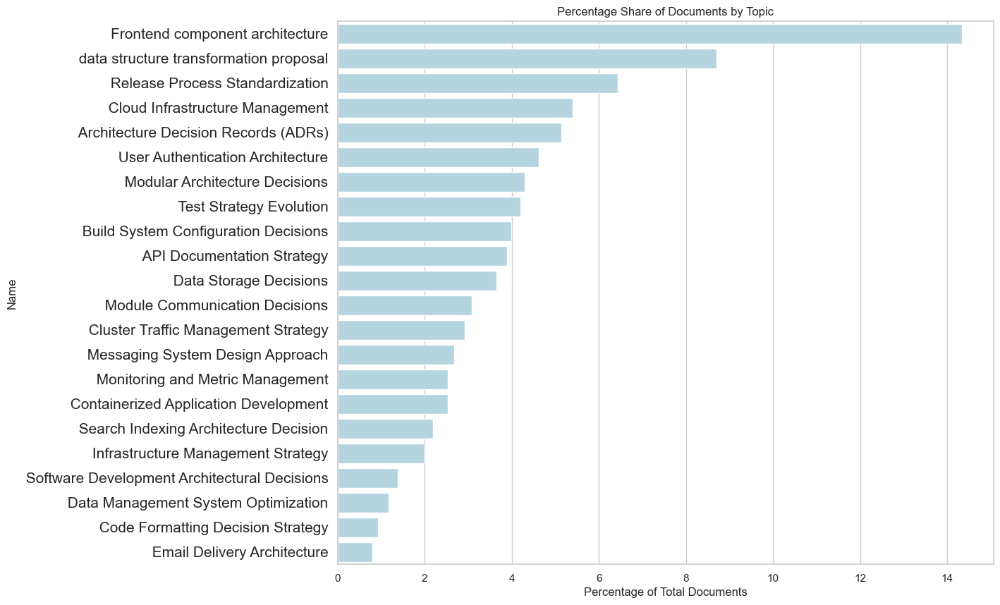

In [107]:
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the total count of documents
total_documents_new = 5368  # as specified by the user

# Calculate the percentage share of each topic
topic_df["Percentage"] = (topic_df["Count"] / total_documents_new) * 100

# Sorting the topics by percentage
new_topic_df = topic_df.sort_values("Percentage", ascending=False)

# Plotting the data with the updated topic names
plt.figure(figsize=(12, 10))
sns.set(style="whitegrid")
sns.barplot(x="Percentage", y="Name", data=new_topic_df, color='lightblue')
# increase font
plt.yticks(fontsize=15)
plt.xlabel("Percentage of Total Documents")
plt.title("Percentage Share of Documents by Topic")
plt.show()


In [134]:
topic_df = topic_df.sort_values("Count", ascending=False)
topic_df.iloc[4]["Keywords"]

['architectural record',
 'architecture record',
 'documentation',
 'changelog',
 'record architecture',
 'record architectural',
 'example description',
 'document',
 'architectural',
 'structure']

In [133]:
new_topic_df

,Topic,Count,Name,Representation,Keywords,Representative_Docs,Percentage
1,0,770,Frontend component architecture,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,14.344262
6,5,467,data structure transformation proposal,[data structure transformation proposal],"[database, schema, sql, metadata, implementati...",[adr supporting nosql backends jean cochrane o...,8.699702
5,4,345,Release Process Standardization,[Release Process Standardization],"[versioning, release note, repository, pull re...",[new release process updating release process ...,6.426975
15,14,290,Cloud Infrastructure Management,[Cloud Infrastructure Management],"[kubernetes, cloud platform, cluster, elastics...",[kubernetes cluster per environment scope web ...,5.402385
2,1,276,Architecture Decision Records (ADRs),[Architecture Decision Records (ADRs)],"[architectural record, architecture record, do...",[documenting architecture architecture agile p...,5.141580
3,2,248,User Authentication Architecture,[User Authentication Architecture],"[access control, authorization, oauth, authent...",[determine new authentication system open appa...,4.619970
16,15,231,Modular Architecture Decisions,[Modular Architecture Decisions],"[implement, interface, implementation, module,...",[drop legacy new code restriction originally p...,4.303279
4,3,225,Test Strategy Evolution,[Test Strategy Evolution],"[test suite, testing framework, unit testing, ...",[title follow test pyramid area productoperati...,4.191505
18,17,214,Build System Configuration Decisions,[Build System Configuration Decisions],"[configuration file, maven, build tool, gradle...",[adr groovy proposed author damir murat damirm...,3.986587
8,7,209,API Documentation Strategy,[API Documentation Strategy],"[api management, apis, api, openapi, schema, e...",[adrapidocumentation title api documentation g...,3.893443


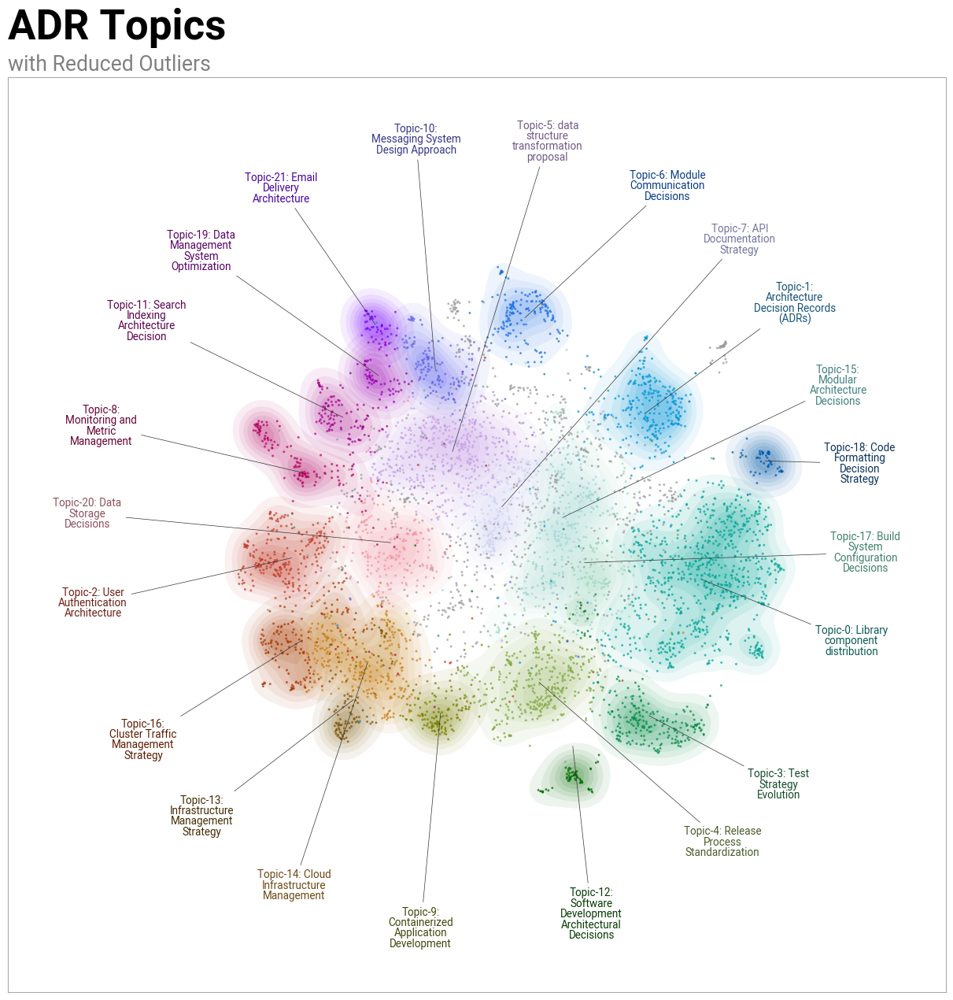

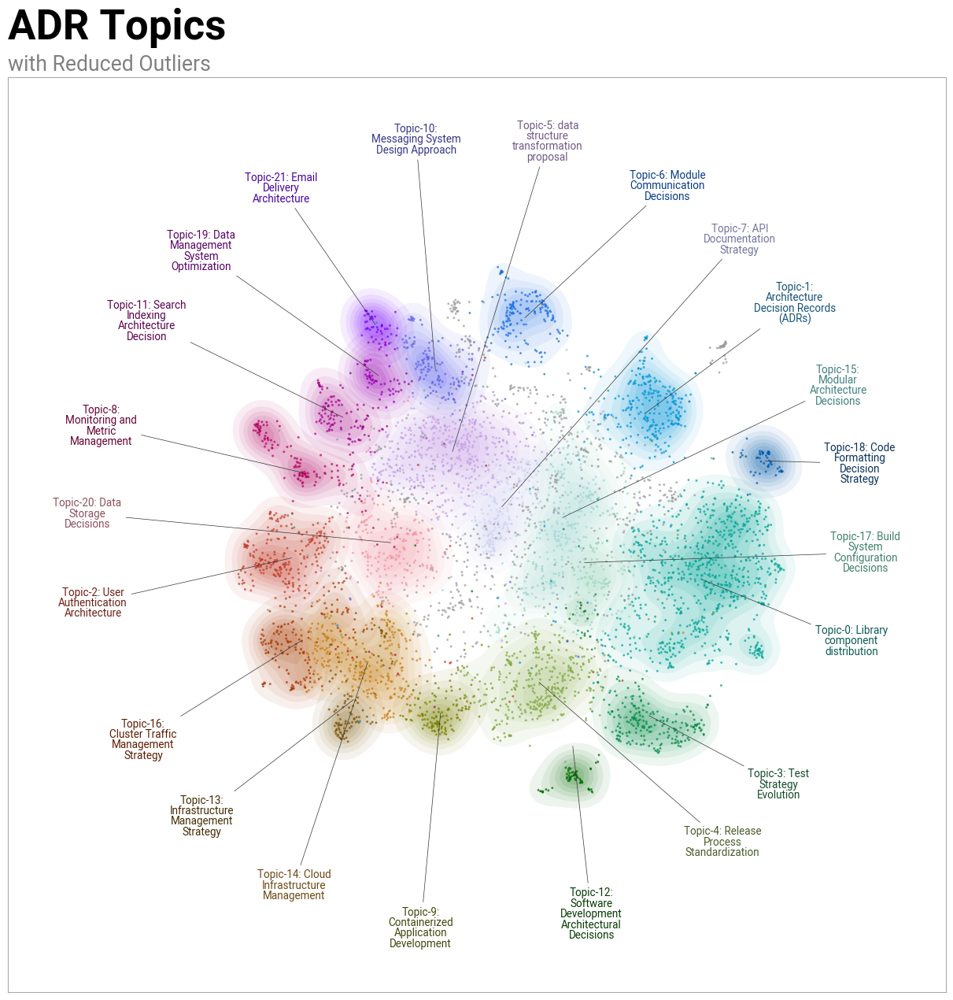

In [39]:
bert_topic_1.visualize_document_datamap(cleaned_texts, embeddings=embeddings, topics=new_topics,
                                         title="ADR Topics", sub_title="with reduced outliers")

In [37]:
bert_topic_1.visualize_heatmap()

In [43]:
bert_topic_1.get_document_info(cleaned_texts)

,Document,Topic,Name,Representation,Keywords,Representative_Docs,Top_n_words,Probability,Representative_document
0,adr react framework frontend development frame...,0,0_Library component distribution,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,Library component distribution,1.000000,False
1,adr libuser october weve decided build user st...,0,0_Library component distribution,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,Library component distribution,0.075532,False
2,data attribute configuring gtm container track...,0,0_Library component distribution,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,Library component distribution,0.074974,False
3,kind architecture record adr create datetime r...,-1,-1_Service API Configuration Decisions,[Service API Configuration Decisions],"[api, endpoint, workflow, service, implement, ...",[firebase infrastructure deciders eimi james a...,Service API Configuration Decisions,0.678391,False
4,title available stock improvement area invento...,-1,-1_Service API Configuration Decisions,[Service API Configuration Decisions],"[api, endpoint, workflow, service, implement, ...",[firebase infrastructure deciders eimi james a...,Service API Configuration Decisions,0.578125,False
...,...,...,...,...,...,...,...,...,...
5363,web controller decide framework web controller...,0,0_Library component distribution,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,Library component distribution,0.214244,False
5364,yaml configuration file order custom adr templ...,17,17_Build System Configuration Decisions,[Build System Configuration Decisions],"[configuration file, maven, build tool, gradle...",[adr groovy proposed author damir murat damirm...,Build System Configuration Decisions,1.000000,False
5365,password sharing secret easi engineer occasion...,14,14_Cloud Infrastructure Management,[Cloud Infrastructure Management],"[kubernetes, cloud platform, cluster, elastics...",[kubernetes cluster per environment scope web ...,Cloud Infrastructure Management,0.064092,False
5366,kind architecture record adr embracing custom ...,0,0_Library component distribution,[Library component distribution],"[react, component, typescript, npm, framework,...",[create new react application setting redesign...,Library component distribution,0.586172,False


In [45]:
bert_topic_1.get_representative_docs()

{-1: ['firebase infrastructure deciders eimi james alli susie related previous adr see modular architecture adr technical story evaluating firebase backend replacing aws infrastructure except pstt client queue instance talk pstt problem statement quite component build backend get dpe stable point although initially decided development aws working aws quite challenging steep learning curve single project cycle weve reached point infrastructure microservices setup unfortunately resource removed project priority shifted research backend development halted picking development task half baked microservices difficult relearn weve developed complete integration order simplify backend development looking firebase google cloud platform since firebase plaftorm target development startup provides many feature box could speed developing backend namely realtime database authentication keeping possibility open offline mobile multiuser solution must consider technical security development transfer up